# DSCI_100 Section_008 Term Project  
## Title: Predicting Minecraft Players’ Newsletter Subscription from Demographics and Play Behaviour

Course: DSCI-100  
Course Section: 008  
Group No: 005  
Date: 2025/12/06  

## **Introduction**
### 1.1 Backgroud

In this term project, we analyze gameplay data collected from a Minecraft research server operated by a research group in the UBC Department of Computer Science, led by Professor Frank Wood. The server automatically recorded all player activity as users interacted with the virtual world, providing an objective and detailed record of real gameplay behaviour. Our goal is to use these data to better understand how players engage with the server and to explore patterns that could help the research group improve future recruitment efforts and resource planning.

### 1.2 Specific Question
Our main question is:

> **Can a player’s age, gender, experience level, and total hours played predict whether they subscribe to a game-related newsletter?**


### 1.3 Dataset description

For this final project, our predictive analysis focuses on the **player-level dataset** `players.csv`. 
We use `sessions.csv` mainly to understand overall session durations and time ranges, but the main model is built on player-level demographics and total play time

Our **response variable** is `subscribe` (TRUE/FALSE), and our **explanatory variables** are `Age`, `gender`, `experience`, and `played_hours`. 
The goal is to build and evaluate a classification model that predicts newsletter subscription from these features.

### File Summaries

| File | Rows (Observations) | Columns (Variables) | Description |
|------|---------------------|---------------------|--------------|
| `players.csv` | 196 | 7 | Player information |
| `sessions.csv` | 1535 | 5 | Session data of each play round |

  - `players.csv` — one observation per unique player. Includes demographic and player's information.
-------------
  - `experience`: self-reported Minecraft experience (e.g., *Beginner*, *Amateur*, *Regular*, *Veteran*, *Pro*).
  - `subscribe`: logical (TRUE/FALSE) indicating whether the player subscribed to the newsletter.
  - `hashedEmail`: anonymized player identifier.
  - `played_hours`: total hours played on the server.
  - `name`: pseudonym.
  - `gender`: self-reported gender identity.
  - `Age`: player age in years.


### Variables in `players.csv` (the code of the summary please see below)

| Variable | Type | Description | Summary|
|-----------|------|--------------|--------------|
| `experience` | Character | Player's game experience level | Amateur:63  Beginner:35  Pro:14  Regular:36  Veteran:48|
| `subscibe` | Logical vectors | Subscribe Status of the game | False: 52 True: 144|
| `hashedEmail` | Character | Email Hashed Addressed(privacy) | 196 Observations|
| `played_hours` | Double | Total game hour of player | Min:0.00  Max:223.10  IQR:0.60  Mean:5.85  Median:0.10|
| `name` | Character | Player's name | 196 Observations|
| `gender` | Character | Player's gender | Agender:2 Female:37  Male:124  Non-binary:15 Other:1  Prefer_not_to_say:11  Two_Spirited:6|
| `Age` | Integar | Player's age | Min:9.00  Max:58.00  IQR:5.75  Mean:21.14  Median:19.00|


In [1]:
### Run this cell before continuing.
library(tidyverse)
library(tidymodels)
library(lubridate)
library(repr)

set.seed(123)

── Attaching core tidyverse packages ──────────────────────── tidyverse 2.0.0 ──
✔ dplyr     1.1.4     ✔ readr     2.1.5
✔ forcats   1.0.0     ✔ stringr   1.5.1
✔ ggplot2   3.5.1     ✔ tibble    3.2.1
✔ lubridate 1.9.3     ✔ tidyr     1.3.1
✔ purrr     1.0.2     
── Conflicts ────────────────────────────────────────── tidyverse_conflicts() ──
✖ dplyr::filter() masks stats::filter()
✖ dplyr::lag()    masks stats::lag()
ℹ Use the conflicted package (<http://conflicted.r-lib.org/>) to force all conflicts to become errors
── Attaching packages ────────────────────────────────────── tidymodels 1.1.1 ──

✔ broom        1.0.6     ✔ rsample      1.2.1
✔ dials        1.3.0     ✔ tune         1.1.2
✔ infer        1.0.7     ✔ workflows    1.1.4
✔ modeldata    1.4.0     ✔ workflowsets 1.0.1
✔ parsnip      1.2.1     ✔ yardstick    1.3.1
✔ recipes      1.1.0     

── Conflicts ───────────────────────────────────────── tidymodels_conflicts() ──
✖ scales::discard() masks purrr::discard()
✖ dplyr::filt

## **Method & Results**
### Load Data: directly from GitHub so the notebook runs without local files

In [22]:
# Load Data: directly from GitHub so the notebook runs without local files
players <- read.csv("https://raw.githubusercontent.com/PapillonH/DSCI100_UBC_TermProject_2025W1/refs/heads/main/players.csv")

sessions <- read.csv("https://raw.githubusercontent.com/PapillonH/DSCI100_UBC_TermProject_2025W1/refs/heads/main/sessions.csv")

head(players)
head(sessions)

,experience,subscribe,hashedEmail,played_hours,name,gender,Age
,<chr>,<lgl>,<chr>,<dbl>,<chr>,<chr>,<int>
1,Pro,TRUE,f6daba428a5e19a3d47574858c13550499be23603422e6a0ee9728f8b53e192d,30.3,Morgan,Male,9
2,Veteran,TRUE,f3c813577c458ba0dfef80996f8f32c93b6e8af1fa939732842f2312358a88e9,3.8,Christian,Male,17
3,Veteran,FALSE,b674dd7ee0d24096d1c019615ce4d12b20fcbff12d79d3c5a9d2118eb7ccbb28,0.0,Blake,Male,17
4,Amateur,TRUE,23fe711e0e3b77f1da7aa221ab1192afe21648d47d2b4fa7a5a659ff443a0eb5,0.7,Flora,Female,21
5,Regular,TRUE,7dc01f10bf20671ecfccdac23812b1b415acd42c2147cb0af4d48fcce2420f3e,0.1,Kylie,Male,21
6,Amateur,TRUE,f58aad5996a435f16b0284a3b267f973f9af99e7a89bee0430055a44fa92f977,0.0,Adrian,Female,17


,hashedEmail,start_time,end_time,original_start_time,original_end_time
,<chr>,<chr>,<chr>,<dbl>,<dbl>
1,bfce39c89d6549f2bb94d8064d3ce69dc3d7e72b38f431d8aa0c4bf95ccee6bf,30/06/2024 18:12,30/06/2024 18:24,1.71977e+12,1.71977e+12
2,36d9cbb4c6bc0c1a6911436d2da0d09ec625e43e6552f575d4acc9cf487c4686,17/06/2024 23:33,17/06/2024 23:46,1.71867e+12,1.71867e+12
3,f8f5477f5a2e53616ae37421b1c660b971192bd8ff77e3398304c7ae42581fdc,25/07/2024 17:34,25/07/2024 17:57,1.72193e+12,1.72193e+12
4,bfce39c89d6549f2bb94d8064d3ce69dc3d7e72b38f431d8aa0c4bf95ccee6bf,25/07/2024 03:22,25/07/2024 03:58,1.72188e+12,1.72188e+12
5,36d9cbb4c6bc0c1a6911436d2da0d09ec625e43e6552f575d4acc9cf487c4686,25/05/2024 16:01,25/05/2024 16:12,1.71665e+12,1.71665e+12
6,bfce39c89d6549f2bb94d8064d3ce69dc3d7e72b38f431d8aa0c4bf95ccee6bf,23/06/2024 15:08,23/06/2024 17:10,1.71916e+12,1.71916e+12


### Data wrangling and preparation

For modelling, we restrict attention to the player-level dataset `players.csv`. We:

1. Only selected the necessary column from original dataset
2. Variable "Age" name need to be standardized to lowercase for consistency.
3. Encode categorical variables: convert gender, experience, and subscribe to factor variables for use in predictive models.
4. Drop NA (missing value)


In [23]:
players_clean <- players |>
    select(Age, gender, experience, played_hours, subscribe) |>
    rename(age = Age) |>
    mutate(gender = as.factor(gender),
           experience = as.factor(experience),
           subscribe = as.factor(subscribe))|>
    drop_na(age, played_hours, gender, experience, subscribe)

head(players_clean)
tail(players_clean)

,age,gender,experience,played_hours,subscribe
,<int>,<fct>,<fct>,<dbl>,<fct>
1,9,Male,Pro,30.3,TRUE
2,17,Male,Veteran,3.8,TRUE
3,17,Male,Veteran,0.0,FALSE
4,21,Female,Amateur,0.7,TRUE
5,21,Male,Regular,0.1,TRUE
6,17,Female,Amateur,0.0,TRUE


,age,gender,experience,played_hours,subscribe
,<int>,<fct>,<fct>,<dbl>,<fct>
189,17,Male,Amateur,0.0,FALSE
190,20,Male,Amateur,0.0,TRUE
191,17,Female,Amateur,0.0,TRUE
192,22,Male,Veteran,0.3,FALSE
193,57,Prefer not to say,Amateur,0.0,FALSE
194,17,Male,Amateur,2.3,FALSE


### Exploratory data analysis

To better understand the structure of the players.csv dataset and identify patterns relevant to our classification task, we conducted an exploratory data analysis (EDA) using both tidyverse summary tools and base R summary functions. This allowed us to examine the distribution of key predictors (age, played_hours, gender, experience) as well as the response variable (subscribe).


In [33]:
# Method 1: Using Tidyverse summary the data set
players_clean |>
    summarise( n_players      = n(),
            mean_age       = mean(age),
            median_age     = median(age),
            min_age        = min(age),
            max_age        = max(age),
            mean_hours     = mean(played_hours),
            median_hours   = median(played_hours),
            min_hours      = min(played_hours),
            max_hours      = max(played_hours))

players_clean |> 
    count(gender) |>
    arrange(desc(n))

players_clean |>
    count(experience) |>
    arrange(desc(n))

players_clean |>
    count(subscribe)

# Method 2: Using Base_R function summary the data set
summary(players_clean)

n_players,mean_age,median_age,min_age,max_age,mean_hours,median_hours,min_hours,max_hours
<int>,<dbl>,<dbl>,<int>,<int>,<dbl>,<dbl>,<dbl>,<dbl>
194,21.13918,19,9,58,5.904639,0.1,0,223.1


gender,n
<fct>,<int>
Male,124
Female,37
Non-binary,15
Prefer not to say,11
Two-Spirited,5
Agender,2


experience,n
<fct>,<int>
Amateur,63
Veteran,48
Beginner,35
Regular,35
Pro,13


subscribe,n
<fct>,<int>
FALSE,52
TRUE,142


      age                      gender       experience  played_hours    
 Min.   : 9.00   Agender          :  2   Amateur :63   Min.   :  0.000  
 1st Qu.:17.00   Female           : 37   Beginner:35   1st Qu.:  0.000  
 Median :19.00   Male             :124   Pro     :13   Median :  0.100  
 Mean   :21.14   Non-binary       : 15   Regular :35   Mean   :  5.905  
 3rd Qu.:22.75   Other            :  0   Veteran :48   3rd Qu.:  0.600  
 Max.   :58.00   Prefer not to say: 11                 Max.   :223.100  
                 Two-Spirited     :  5                                  
 subscribe  
 FALSE: 52  
 TRUE :142  
            
            
            
            
            

### Exploratory Data Analysis Visualizations

To explore potential relationships between player characteristics and subscription behaviour, we created several visualizations that highlight how key predictors vary across the dataset. These plots help us identify patterns that may influence the performance of the classification model. Specifically, we examine how subscription rates differ across experience levels, how total play time compares between subscribers and non-subscribers, and how overall play time is distributed among players. Together, these visualizations provide insight into which variables may be useful for predicting whether a player subscribes to the newsletter.

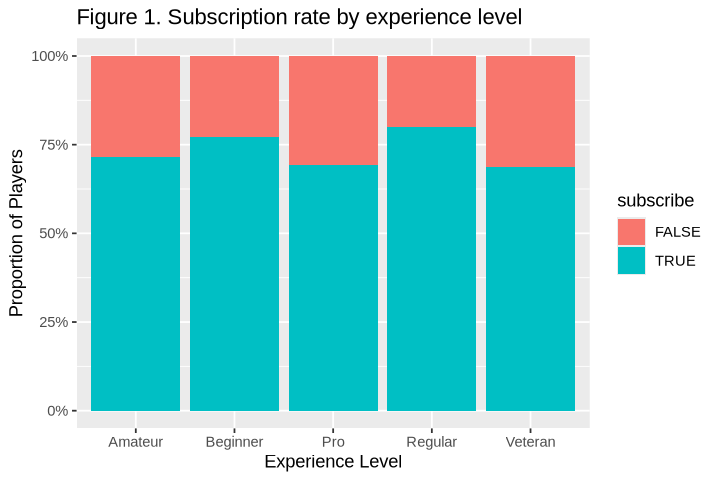

In [49]:
bar_plot <- players_clean|>
    ggplot(aes(x = experience, fill = subscribe)) +
    geom_bar(position = "fill") +
    labs(title = "Figure 1. Subscription rate by experience level",
       x = "Experience Level",
       y = "Proportion of Players") +
    scale_y_continuous(labels = scales::percent)

bar_plot

**Figure 1** shows the proportion of subscribers and non-subscribers within each experience level. From the bar plot of subsrcibe status and experience level, we can tell: The majority of players across all experience levels are subscribers. Higher experience levels (Veteran, Pro) show a less poportion of subscribers than lower levels (Amateur, Regular).
This suggests that experience level has some predictive power. In modeling, this variable could still contribute useful information to help predict subscription probability.

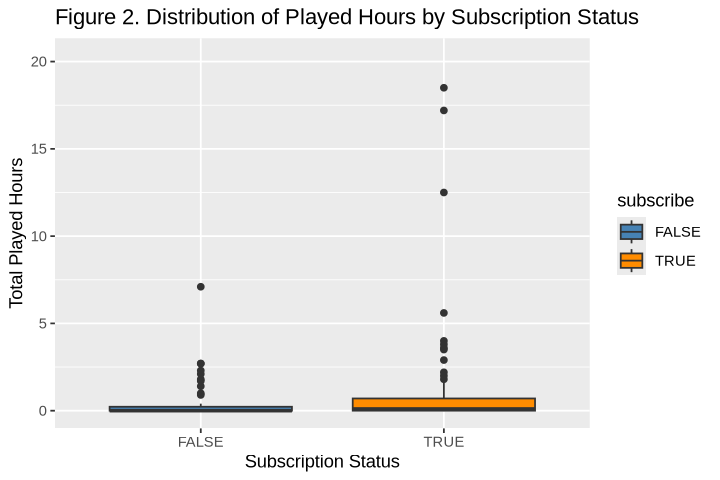

In [98]:
# Boxplot Reference: https://r-graph-gallery.com/267-reorder-a-variable-in-ggplot2.html
boxplot <- players_clean|>
    ggplot(aes(x = subscribe, y = played_hours, fill = subscribe)) +
    geom_boxplot() +
    coord_cartesian(ylim = quantile(players_clean$played_hours, c(0, 0.95))) + 
    labs(title = "Figure 2. Distribution of Played Hours by Subscription Status",
        x = "Subscription Status",
        y = "Total Played Hours") +
    scale_fill_manual(values = c("FALSE" = "steelblue", "TRUE" = "darkorange"))
boxplot

**Figure 2** compares the distribution of total hours played for subscribers and non-subscribers. This helps us see whether heavy players tend to subscribe more often than casual players. If the median and upper quartiles for subscribers are higher, that would suggest a positive relationship between engagement and subscription.

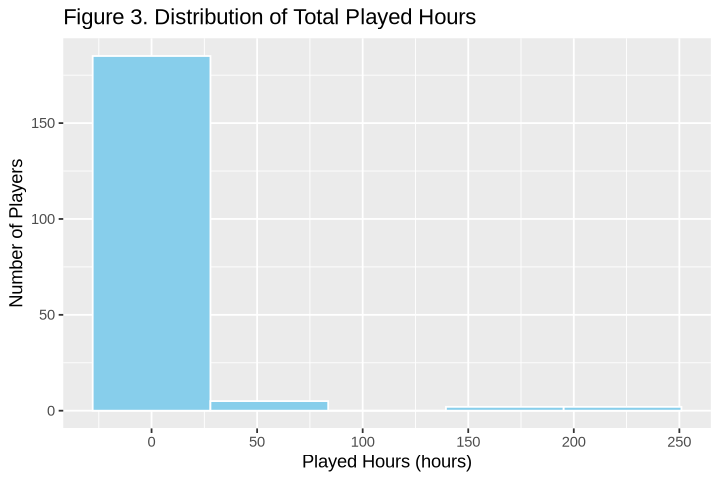

In [64]:
hist_plot <- players_clean|>
    ggplot(aes(x = played_hours)) +
    geom_histogram(bins = 5, fill = "skyblue", color = "white") +
    labs(title = "Figure 3. Distribution of Total Played Hours",
        x = "Played Hours (hours)",
        y = "Number of Players") 
hist_plot

**Figure 3** is the histogram of dirstribution of total play hours, we can tell: most players have played only a few hours, there's only a small group has spent over 100 hours on the server. It's a Strong right skewed distribution.
The overall pattern also suggests that playtime could be a strong indicator of engagement, which is potentially related to whether a player subscribes to the newsletter.

### Performs the data analysis: Modelling approach

Our response variable `subscribe` is binary (TRUE/FALSE), so this is a classification problem. We use a **k-Nearest Neighbours (KNN)** classifier implemented with the `tidymodels` framework:

- **Predictors:** `Age`, `gender`, `experience`, `played_hours`.
- **Response:** `subscribe`.

KNN predicts the subscription status of a given player by looking at the most similar players in the training set and taking a majority vote. To use KNN properly, numeric variables must be standardised and categorical variables converted to dummy (one-hot) indicators.

#### Method and Plan:
1. Split the data into a training set (70%) and a test set (30%), stratified by `subscribe`.
2. Define a recipe:
   - encode categorical predictors  
   - standardized numeric predictors  
3. Specify a KNN model with the number of neighbours `k` treated as a tuning parameter.
4. Use 5-fold cross-validation on the training set to tune `k`.
5. Fit the final model using the best `k` and evaluate it on the held-out test set.


#### Data Analysis:

In [75]:
# a): Train/Test dataset split

player_split <- initial_split(players_clean, prop = 0.7, strata = subscribe)
player_training <- training(player_split)
player_testing <- testing(player_split)

In [76]:
# b): Recipe Build
# Standarized numeric variables(age & played_hours)
# Convert factor to numeric dummy variables (experience & gender)

player_recipe <- recipe(subscribe ~ age + played_hours + gender + experience,
                       data = player_training) |>
    step_dummy(all_nominal_predictors()) |> # experience & gender -> dummy variables
    step_zv(all_predictors()) |>  # drop zero_variance dummy variables
    step_normalize(all_numeric_predictors()) # standardized variables (scale and center)

In [77]:
# c): KNN model spec

player_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = tune()) |>
    set_engine("kknn") |>
    set_mode("classification")

neighbors
<dbl>
11


neighbors,.config
<dbl>,<chr>
11,Preprocessor1_Model03


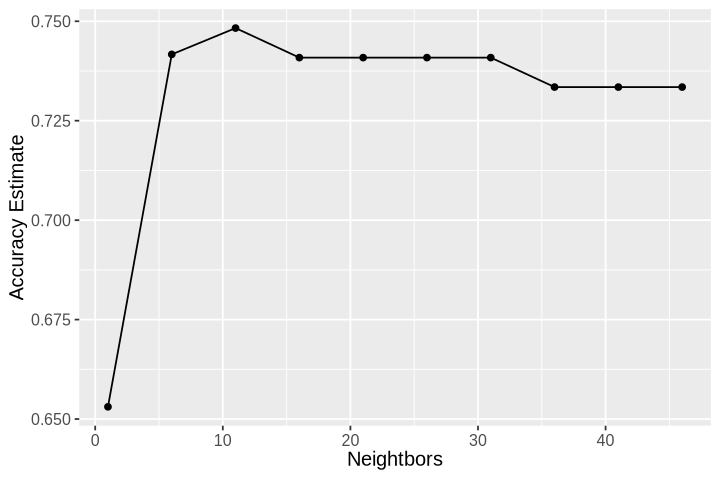

In [78]:
# d): 5-fold cross-validation, Workflow, tuning

player_vflod <- vfold_cv(player_training, v = 5, strata = subscribe)

# workflow build up
player_knn_workflow <- workflow()|>
    add_recipe(player_recipe)|>
    add_model(player_spec)

# build the gridval table
gridvals <- tibble(neighbors = seq(from = 1, to = 50, by = 5))

# apply workflow to 5-fold
player_tuned <- player_knn_workflow |>
    tune_grid(resamples = player_vflod, grid = gridvals)

# find the best k-value and plot visualization
player_result <- collect_metrics(player_tuned)

accuracies_lots <- player_result |>
    filter(.metric == "accuracy")

# Method1:  The way we learn in class, put in order and then slice the min mean neighbor
best_k <- accuracies_lots |>
    arrange(desc(mean)) |>
    head(1) |>
    select(neighbors)
best_k

# Plot the Accuracy Estimate visulization
cross_val_plot <- ggplot(accuracies_lots, aes(x = neighbors, y = mean)) + 
    geom_point() +
    geom_line() +
    labs(x = "Neightbors", y = "Accuracy Estimate") + 
    theme(text = element_text(size = 12))

cross_val_plot

# Method 2: Just select best knn with library function, and directly apply to finalize_workflow later
best_knn <- select_best(player_tuned, metric = "accuracy")
best_knn

In [12]:
# e): Fit final model on training data
# Method1:  The way we learn in class, build new spec and workflow
player_new_spec <- nearest_neighbor(weight_func = "rectangular", neighbors = best_k) |>
    set_engine("kknn") |>
    set_mode("classification")

player_fitting <- workflow() |>
    add_recipe(player_recipe) |>
    add_model(player_new_spec) |>
    fit(data = player_training)
player_fitting

player_predictions <- predict(player_fitting, player_testing) |>
    bind_cols(player_testing)
head(player_predictions)

player_metrics <- player_predictions |>
    metrics(truth = subscribe, estimate = .pred_class) |>
    filter(.metric == "accuracy")
player_metrics

player_conf_mat <- player_predictions |>
    conf_mat (truth = subscribe, estimate = .pred_class)

player_conf_mat

# Method 2: Just directly apply to finalize_workflow with best knn
final_knn_workflow <- finalize_workflow(player_knn_workflow, best_knn)

final_fit <- last_fit(final_knn_workflow, player_split)

test_metric <- collect_metrics(final_fit)

══ Workflow [trained] ══════════════════════════════════════════════════════════
Preprocessor: Recipe
Model: nearest_neighbor()

── Preprocessor ────────────────────────────────────────────────────────────────
3 Recipe Steps

• step_dummy()
• step_zv()
• step_normalize()

── Model ───────────────────────────────────────────────────────────────────────

Call:
kknn::train.kknn(formula = ..y ~ ., data = data, ks = min_rows(structure(list(    neighbors = 16), row.names = c(NA, -1L), class = c("tbl_df", "tbl", "data.frame")), data, 5), kernel = ~"rectangular")

Type of response variable: nominal
Minimal misclassification: 0.2592593
Best kernel: rectangular
Best k: 16

.pred_class,age,gender,experience,played_hours,subscribe
<fct>,<int>,<fct>,<fct>,<dbl>,<fct>
TRUE,9,Male,Pro,30.3,TRUE
TRUE,17,Male,Veteran,3.8,TRUE
TRUE,17,Male,Veteran,0.0,FALSE
TRUE,21,Female,Amateur,0.7,TRUE
TRUE,21,Male,Amateur,0.0,FALSE
TRUE,17,Male,Pro,0.0,TRUE


.metric,.estimator,.estimate
<chr>,<chr>,<dbl>
accuracy,binary,0.7118644


          Truth
Prediction FALSE TRUE
     FALSE     0    1
     TRUE     16   42

#### Visualization of Model Predictions
To better understand how the KNN classifier behaves on our data, we generated two visualizations:  
(1) a confusion matrix summarizing overall prediction performance  
(2) a shaded scatterplot showing how the classifier assigns subscription labels across the feature space  
These visual diagnostics help us evaluate whether the model is learning meaningful patterns and where its predictions may be limited.

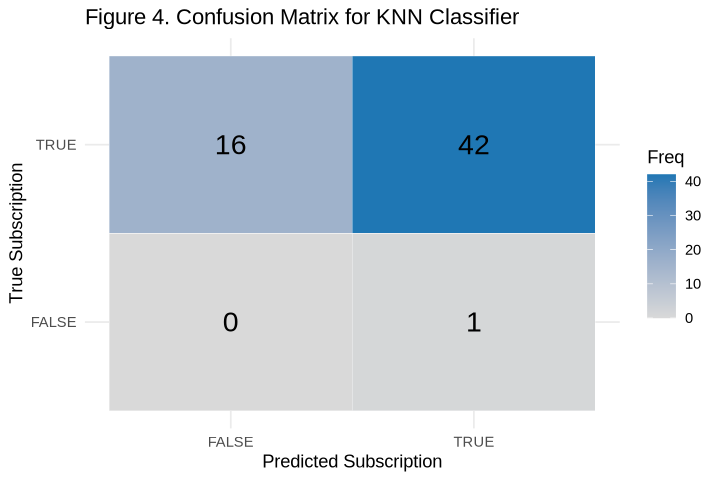

In [99]:
# Confusion Matrix Plot Reference: https://ggplot2.tidyverse.org/reference/geom_tile.html
cm_tidy <- as.data.frame(player_conf_mat$table)
# Rename columns for clarity
colnames(cm_tidy) <- c("Truth", "Prediction", "Freq")

ggplot(cm_tidy, aes(x = Prediction, y = Truth, fill = Freq)) +
    geom_tile(color = "white") +
    geom_text(aes(label = Freq), size = 6) +
    scale_fill_gradient(low = "#D9D9D9", high = "#1F77B4") +
    labs(title = "Figure 4. Confusion Matrix for KNN Classifier",
        x = "Predicted Subscription",
        y = "True Subscription") +
    theme_minimal()

**Figure 4.** plot summarizes how well the model classified players in the test set. The classifier correctly identified most subscribers but rarely predicted “FALSE,” which led to many incorrect “TRUE” predictions. This pattern matches the imbalance in the dataset, where most players are subscribers.

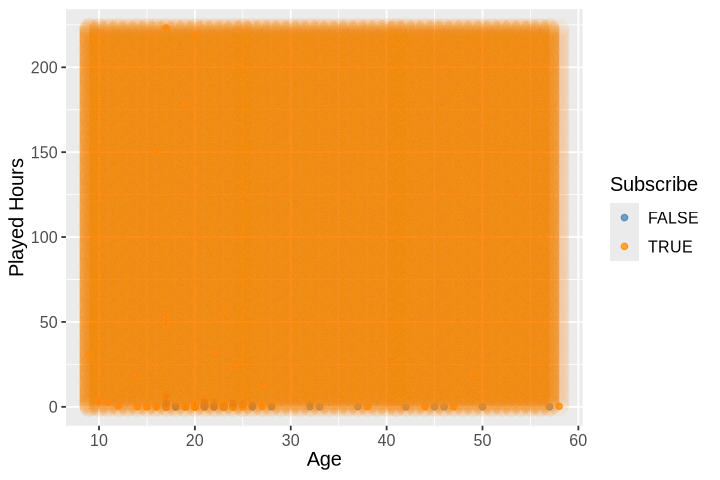

In [97]:
# CODE USING THE TEXTBOOK(Chapter 6) TO CREATE THE SHADED BACKRGROUND SCATTERPLOT 
age_grid   <- seq(min(players_clean$age), max(players_clean$age), length.out = 200)
hours_grid <- seq(min(players_clean$played_hours),
                  max(players_clean$played_hours),
                  length.out = 200)

example_gender <- players_clean$gender[1]
example_experience <- players_clean$experience[1]

grid <- expand.grid(age = age_grid,
                    played_hours = hours_grid,
                    gender       = example_gender,
                    experience   = example_experience) |>
                    as_tibble() |>
                    mutate(age = as.integer(age))

knnPredGrid <- predict(wf_trained, new_data = grid)

prediction_table <- bind_cols(grid, knnPredGrid) |>
      rename(pred_subscribe = .pred_class)

figure5 <-
      ggplot() +
      geom_point(data = players_clean,
        mapping = aes(x = age, y = played_hours, color = subscribe),alpha = 0.75) +
      geom_point(data = prediction_table,
        mapping = aes(x = age, y = played_hours, color = pred_subscribe),
        alpha = 0.03,
        size  = 5,
        show.legend = FALSE) +
      labs(color = "Subscribe", x = "Age", y = "Played Hours") +
      scale_color_manual(values = c("FALSE" = "steelblue", "TRUE"  = "darkorange")) +
      theme(text = element_text(size = 12))

figure5

**Figure 5.** scatterplot shows how the model predicts subscription across a grid of age and playtime values. The faded background points illustrate the model’s predictions, while the solid points show the real data. We can see that the model predicts “TRUE” almost everywhere, suggesting that it doesn’t find strong boundaries between the two classes and mainly follows the majority class pattern.

## **Discussion**
In this project, we tried to use a K-nearest neighbours (KNN) classifier to predict whether a player would subscribe to the newsletter based on their age, gender, experience level, and total hours played. Our final test accuracy was around 71%, which at first seems decent. **Expection:** However, once we compare this result to the structure of the data, it becomes clear that the model is not performing as well as it looks.

Although our KNN classifier did not achieve strong predictive results, the process helped us understand the limitations of the dataset and the importance of choosing useful features. The project shows that even when a model doesn’t perform well, the analysis can still be meaningful by pointing out what kinds of data would be needed for better predictions.

**Finding:** From the model predictions, we reflect on exploratory data analysis, we noticed that none of the predictors separate subscribers and non-subscribers very clearly. Most players subscribed regardless of experience level, and both subscribers and non-subscribers tended to have low playtime. Age also did not show any pattern that would help distinguish the two groups. Because the relationships are weak, the model does not have much information to learn from.

This is also reflected in the confusion matrix: the model predicts “TRUE” (subscriber) very often, which leads to a lot of false positives. Since about 73% of players in the dataset are already subscribers, a baseline model that predicts “TRUE” for everyone would achieve similar accuracy. This means our KNN model is not really outperforming a simple, non-data-driven guess. The issue is not the algorithm—it’s that the features we used do not strongly relate to subscription behaviour.

Overall, our results are reasonable given the patterns observed in the data. **Impact:** The model performs about as well as expected based on the available features, and the process highlights the importance of understanding the dataset before choosing a modelling approach. This aligns with findings in the literature, which emphasize that careful exploratory data analysis plays a crucial role in determining how successful a machine learning model can be **(Rastogi et al., 2025)**. The performance of any machine learning model depends heavily on the features it is built on. If the predictors do not show clear patterns or differences between the groups we want to classify, then even well-tuned models will have limited accuracy.

Future work could explore whether adding more variables or applying techniques to handle class imbalance might improve prediction quality, but within the scope of this project, our model reflects the underlying structure of the data appropriately. Our findings suggest that prediction based on basic demographic features has limited usefulness in this setting

**Future Question:** This project raises several future questions. What types of in-game behaviour truly predict subscription likelihood? Would a richer set of gameplay metrics improve accuracy significantly? How does the timing of play sessions or player retention patterns relate to subscription decisions? Investigating these behavioural dimensions, rather than demographic ones, may offer more powerful insights.

### Reference (APA citation):   
Rastogi, A., Chauhan, S., & Sharma, K. (2025). The imperative of exploratory data analysis in machine learning. Scholars Journal of Engineering and Technology, 13(1), 30–44.